In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/sneaker-image-dataset/sneaker_images_1024x1024/resized_padded_new_image_540.jpg
/kaggle/input/sneaker-image-dataset/sneaker_images_1024x1024/padded_image_869.jpg
/kaggle/input/sneaker-image-dataset/sneaker_images_1024x1024/resized_padded_new_image_291.jpg
/kaggle/input/sneaker-image-dataset/sneaker_images_1024x1024/padded_image_1566.jpg
/kaggle/input/sneaker-image-dataset/sneaker_images_1024x1024/resized_padded_new_image_3539.jpg
/kaggle/input/sneaker-image-dataset/sneaker_images_1024x1024/resized_padded_vans_347.jpg
/kaggle/input/sneaker-image-dataset/sneaker_images_1024x1024/clean_important_5822.jpg
/kaggle/input/sneaker-image-dataset/sneaker_images_1024x1024/clean_important_8073.jpg
/kaggle/input/sneaker-image-dataset/sneaker_images_1024x1024/image_747.jpg
/kaggle/input/sneaker-image-dataset/sneaker_images_1024x1024/resized_padded_underarmour_26.jpg
/kaggle/input/sneaker-image-dataset/sneaker_images_1024x1024/flipped_2019-01-29_19-00-36_UTC.jpg
/kaggle/input/sneaker-im

In [1]:
import os
import pandas as pd
import numpy as np
import torch
import torchvision
from torchvision.datasets import ImageFolder
import torch.nn as nn
import torchvision.transforms as tt
import torch.nn.functional as F
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
%matplotlib inline
from torchvision.utils import save_image
from torchvision.utils import make_grid
from tqdm.notebook import tqdm

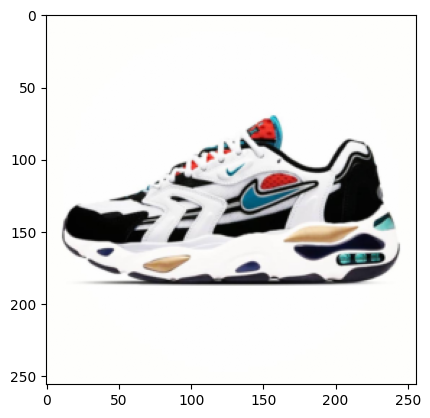

In [32]:
data_path = "../input/sneaker-image-dataset"
image_size = 256
batch_size = 64
normstats = (0.,0.,0.),(1.,1.,1.)
transforms = tt.Compose([tt.Resize(image_size),#resize to make things uniform
                        tt.CenterCrop(image_size),#cropping to the center to avoid distortion
                        tt.ToTensor(),#to a tensor
                        tt.Normalize(*normstats)#normalizing in order to increase effectiveness of our GAN
                        ])
dataset = ImageFolder(data_path, transform = transforms)
img, _ = dataset[0]
plt.imshow(img.permute((1,2,0)))

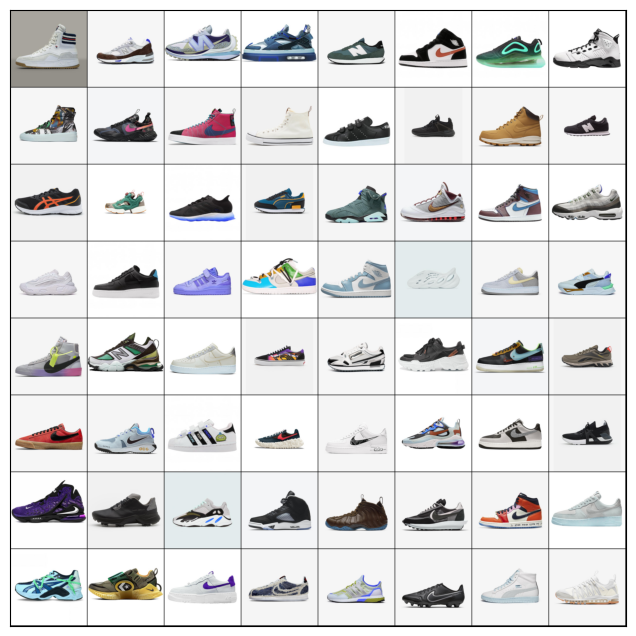

In [33]:
def denorm(img_tensors):
    return img_tensors * normstats[1][0] + normstats[0][0]

def show_batch(dl):#just to show one batch of our data
    for img, _ in dl:
        fig, ax = plt.subplots(figsize=(8,8))
        ax.set_xticks([]);ax.set_yticks([])
        ax.imshow(torchvision.utils.make_grid(img[:64],nrow = 8).permute(1,2,0))
        break

def show_images(images):
    fig, ax = plt.subplots(figsize=(8,8))
    ax.set_xticks([]),ax.set_yticks([])
    ax.imshow(torchvision.utils.make_grid(denorm(images.detach()[:64]),nrow = 8).permute(1,2,0))

dataload = DataLoader(dataset,batch_size,num_workers = 4,shuffle = True, pin_memory=True)#makes our data into batches
show_batch(dataload)

In [34]:
def find_default_device():
    if torch.cuda.is_available():
        return torch.device("cuda")
    else:
        return torch.device('cpu')

In [35]:
device = find_default_device()

In [36]:
device

device(type='cuda')

In [37]:
def to_device(data,device):
    if isinstance(data,(list,tuple)):
        return [to_device(x,device) for x in data]
    else:
        return data.to(device, non_blocking=True)

In [38]:
class DataloaderDeviced():
    def __init__(self,data,device):
        self.data = data
        self.device = device
    def __iter__(self):
        for b in self.data:
            yield to_device(b,self.device)
    def __len__(self):
        return len(self.data)

In [39]:
dataload = DataloaderDeviced(dataload,device)

In [40]:
# Discriminator Model
class Discriminator512(nn.Module):
    def __init__(self):
        super(Discriminator512, self).__init__()
        self.model = nn.Sequential(
            nn.Conv2d(3, 32, kernel_size=3, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.1, inplace=True),
            nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.1, inplace=True),
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.1, inplace=True),
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.1, inplace=True),
            nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.1, inplace=True),
            nn.Conv2d(512, 1024, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(0.1, inplace=True),
            nn.Conv2d(1024, 2048, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(2048),
            nn.LeakyReLU(0.1, inplace=True),
            nn.Conv2d(2048, 1, kernel_size=4, stride=1, padding=0, bias=False),
            nn.Flatten(),
            nn.Sigmoid()
        )
    
    def forward(self, x):
        return self.model(x)

In [41]:
# Discriminator Model
class Discriminator256(nn.Module):
    def __init__(self):
        super(Discriminator256, self).__init__()
        self.model = nn.Sequential(
            nn.Conv2d(3, 32, kernel_size=3, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.1, inplace=True),
            nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.1, inplace=True),
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.1, inplace=True),
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.1, inplace=True),
            nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.1, inplace=True),
            nn.Conv2d(512, 1024, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(0.1, inplace=True),
            nn.Conv2d(1024, 1, kernel_size=4, stride=1, padding=0, bias=False),
            nn.Flatten(),
            nn.Sigmoid()
        )
    
    def forward(self, x):
        return self.model(x)

In [42]:
# Generator Model
class Generator512(nn.Module):
    def __init__(self, latent_dim=256):
        super(Generator512, self).__init__()
        self.model = nn.Sequential(
            nn.ConvTranspose2d(latent_dim, 2048, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(2048),
            nn.LeakyReLU(0.1, inplace=True),
            nn.ConvTranspose2d(2048, 1024, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(0.1, inplace=True),
            nn.ConvTranspose2d(1024, 512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.1, inplace=True),
            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.1, inplace=True),
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.1, inplace=True),
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.1, inplace=True),
            nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.1, inplace=True),
            nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1, bias=False),
            nn.Tanh()
        )
    
    def forward(self, x):
        return self.model(x)

In [43]:
# Generator Model
class Generator256(nn.Module):
    def __init__(self, latent_dim=256):
        super(Generator256, self).__init__()
        self.model = nn.Sequential(
            nn.ConvTranspose2d(latent_dim, 1024, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(0.1, inplace=True),
            nn.ConvTranspose2d(1024, 512, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.1, inplace=True),
            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.1, inplace=True),
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.1, inplace=True),
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.1, inplace=True),
            nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.1, inplace=True),
            nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1, bias=False),
            nn.Tanh()
        )
    
    def forward(self, x):
        return self.model(x)

In [44]:
# GAN Class
class GAN:
    def __init__(self, generator, discriminator, device, latent_dim):
        self.generator = generator
        self.discriminator = discriminator
        self.device = device
        self.latent_dim = latent_dim
        self.generator = to_device(self.generator, device)
        self.discriminator = to_device(self.discriminator, device)
    
    def train_discriminator(self, real_images, opt_d, batch_size):
        opt_d.zero_grad()
        real_preds = self.discriminator(real_images)
        real_targets = torch.ones(real_images.size(0), 1, device=self.device)
        real_loss = F.binary_cross_entropy(real_preds, real_targets)
        real_score = torch.mean(real_preds).item()
        
        latent = torch.randn(batch_size, self.latent_dim, 1, 1, device=self.device)
        fake_images = self.generator(latent)
        
        fake_preds = self.discriminator(fake_images)
        fake_targets = torch.zeros(fake_images.size(0), 1, device=self.device)
        fake_loss = F.binary_cross_entropy(fake_preds, fake_targets)
        fake_score = torch.mean(fake_preds).item()
        
        loss = fake_loss + real_loss
        loss.backward()
        opt_d.step()
        
        return loss.item(), real_score, fake_score
    
    def train_generator(self, opt_g, batch_size):
        opt_g.zero_grad()
        latent = torch.randn(batch_size, self.latent_dim, 1, 1, device=self.device)
        images = self.generator(latent)
        
        targets = torch.ones(batch_size, 1, device=self.device)
        score = self.discriminator(images)
        loss = F.binary_cross_entropy(score, targets)
        
        loss.backward()
        opt_g.step()
        
        return loss.item()
    
    def train(self, dataloader, epochs, lr, start_idx=1):
        loss_d = []
        loss_g = []
        real_scores = []
        fake_scores = []
        
        opt_d = torch.optim.Adam(self.discriminator.parameters(), lr=lr, betas=(0.5, 0.999))
        opt_g = torch.optim.Adam(self.generator.parameters(), lr=lr, betas=(0.5, 0.999))
        
        for epoch in range(epochs):
            for img, _ in tqdm(dataloader):
                img = to_device(img, self.device)
                
                loss, real_score, fake_score = self.train_discriminator(img, opt_d, img.size(0))
                lossg = self.train_generator(opt_g, img.size(0))
                
            loss_d.append(loss)
            loss_g.append(lossg)
            real_scores.append(real_score)
            fake_scores.append(fake_score)
            
            print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
                epoch + 1, epochs, lossg, loss, real_score, fake_score))
            
            self.save_samples(epoch + start_idx)
        
        return loss_g, loss_d, real_scores, fake_scores
    
    def save_samples(self, epoch, savedir='gen512/', show=True):
        os.makedirs(savedir, exist_ok=True)
        fixed_latent = torch.randn(64, self.latent_dim, 1, 1, device=self.device)
        fake_images = self.generator(fixed_latent)
        
        # Saving images
        save_image(fake_images, os.path.join(savedir, f'generated-{epoch}.png'), nrow=8, normalize=True)
        print(f'Saved generated images for epoch {epoch}')
        
        # Optionally displaying images
        if show:
            fig, ax = plt.subplots(figsize=(8, 8))
            ax.set_xticks([]); ax.set_yticks([])
            ax.imshow(make_grid(fake_images.cpu().detach(), nrow=8).permute(1, 2, 0))
            plt.show()
            
            

In [45]:
L = 256
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator = Generator(L)
discriminator = Discriminator()

# Create instance of GAN
gan = GAN(generator, discriminator, device, L)

# Training parameters
epochs = 50
lr = 0.0002
batch_size = 64

# Train the GAN
gan.train(dataload, epochs, lr)

NameError: name 'Generator' is not defined

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [1/50], loss_g: 7.4738, loss_d: 0.0144, real_score: 0.9974, fake_score: 0.0117
Saved generated images for epoch 1


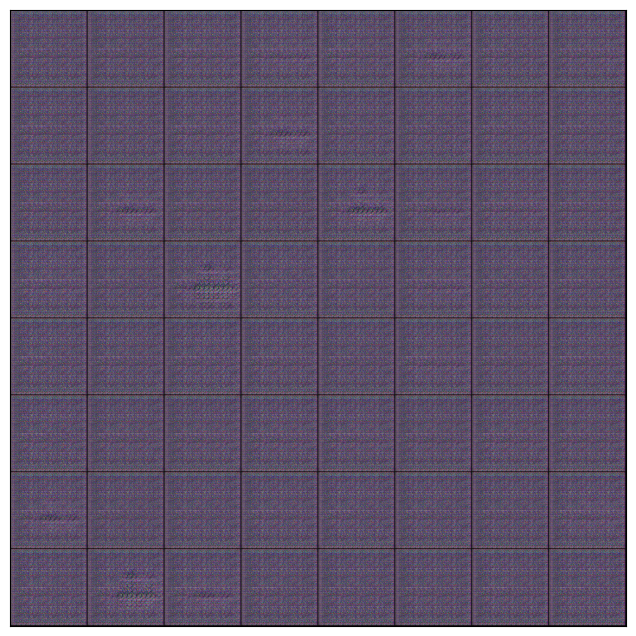

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [2/50], loss_g: 6.6852, loss_d: 0.0033, real_score: 0.9989, fake_score: 0.0022
Saved generated images for epoch 2


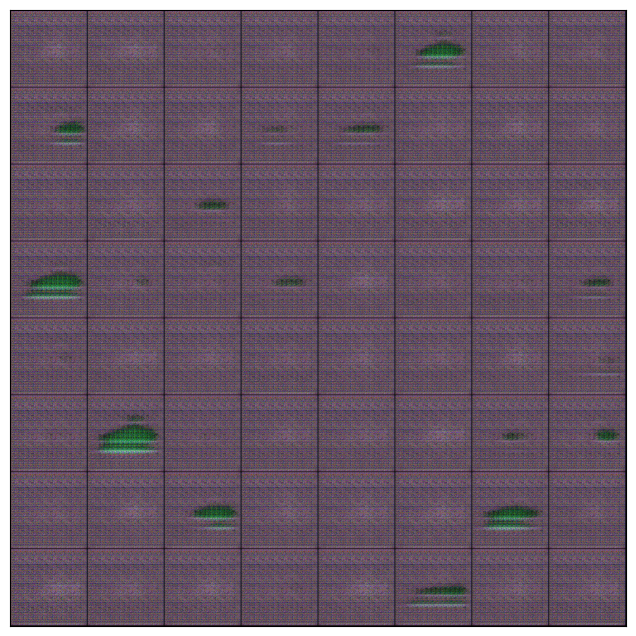

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [3/50], loss_g: 4.2395, loss_d: 0.8521, real_score: 0.7875, fake_score: 0.4305
Saved generated images for epoch 3


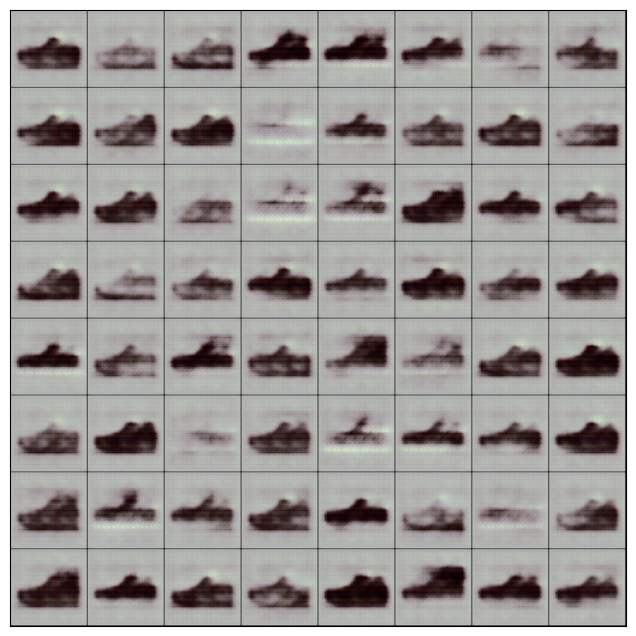

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [4/50], loss_g: 3.8000, loss_d: 0.1896, real_score: 0.8557, fake_score: 0.0216
Saved generated images for epoch 4


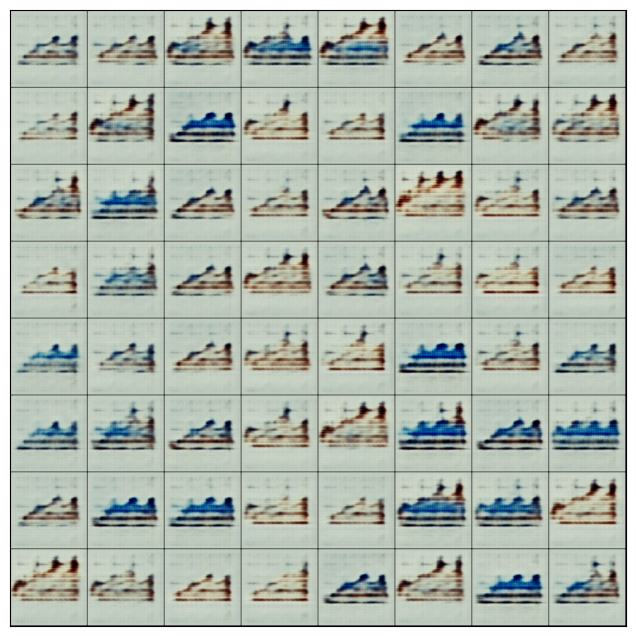

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [5/50], loss_g: 1.6413, loss_d: 0.3120, real_score: 0.7849, fake_score: 0.0507
Saved generated images for epoch 5


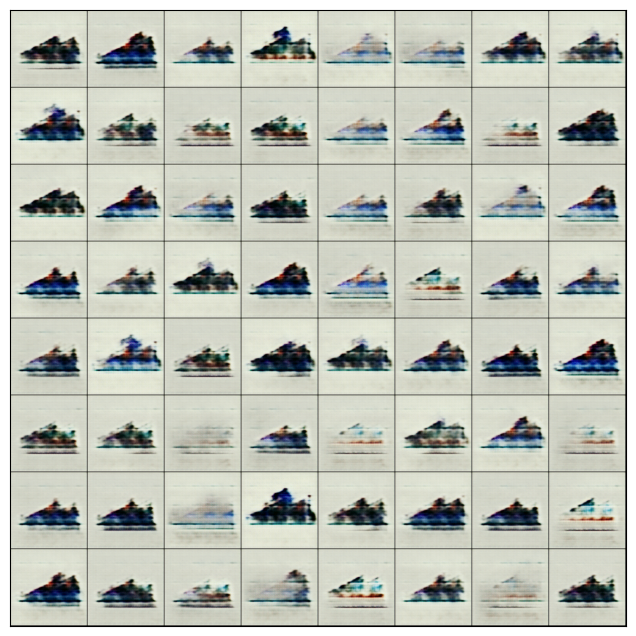

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [6/50], loss_g: 2.5304, loss_d: 0.5000, real_score: 0.9947, fake_score: 0.3469
Saved generated images for epoch 6


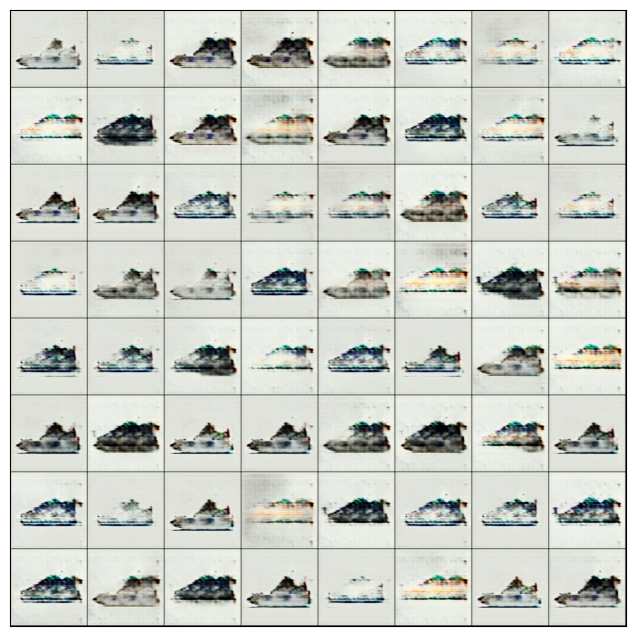

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [7/50], loss_g: 2.9146, loss_d: 0.1204, real_score: 0.9470, fake_score: 0.0608
Saved generated images for epoch 7


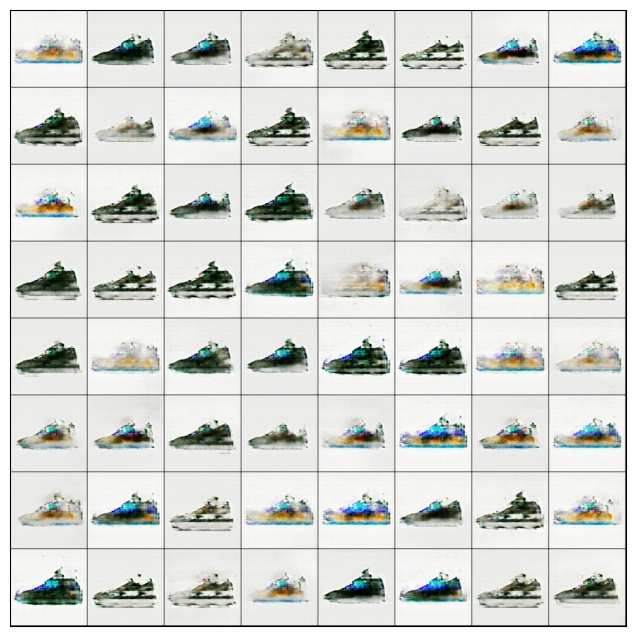

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [8/50], loss_g: 4.1738, loss_d: 0.1050, real_score: 0.9307, fake_score: 0.0316
Saved generated images for epoch 8


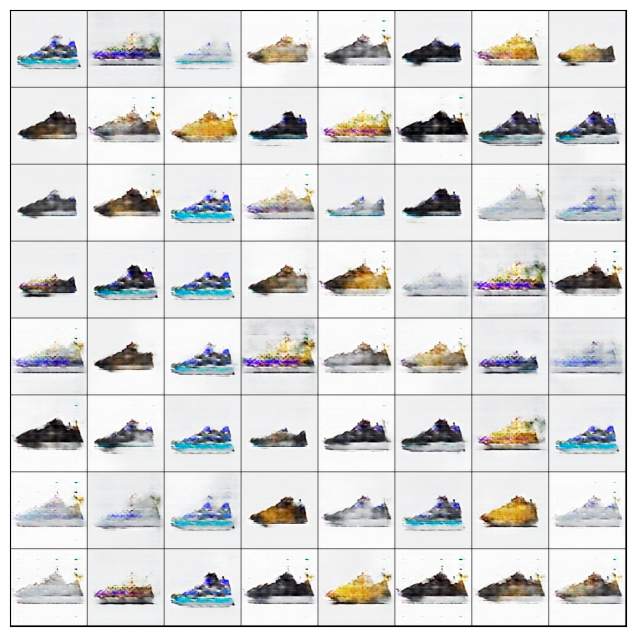

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [9/50], loss_g: 0.0585, loss_d: 0.5025, real_score: 0.6546, fake_score: 0.0047
Saved generated images for epoch 9


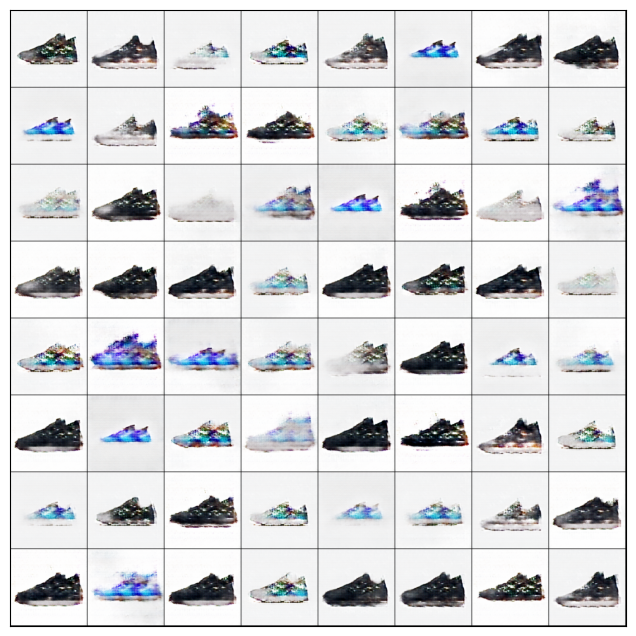

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [10/50], loss_g: 5.5655, loss_d: 0.1035, real_score: 0.9412, fake_score: 0.0398
Saved generated images for epoch 10


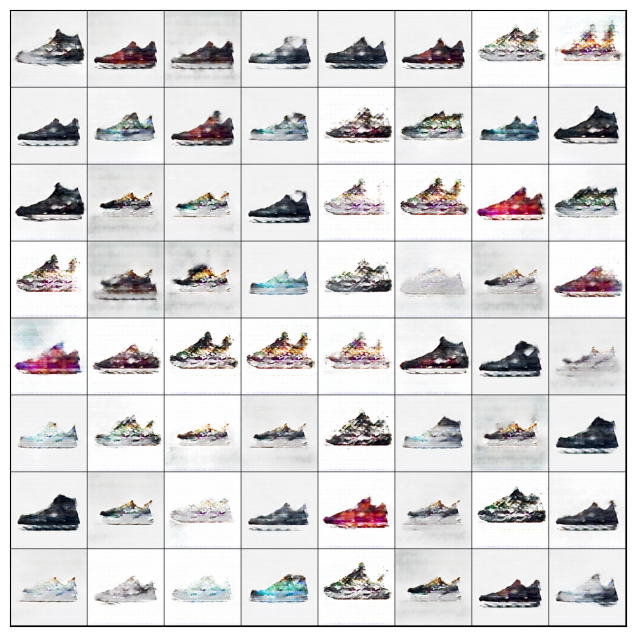

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [11/50], loss_g: 2.4967, loss_d: 0.1447, real_score: 0.8914, fake_score: 0.0191
Saved generated images for epoch 11


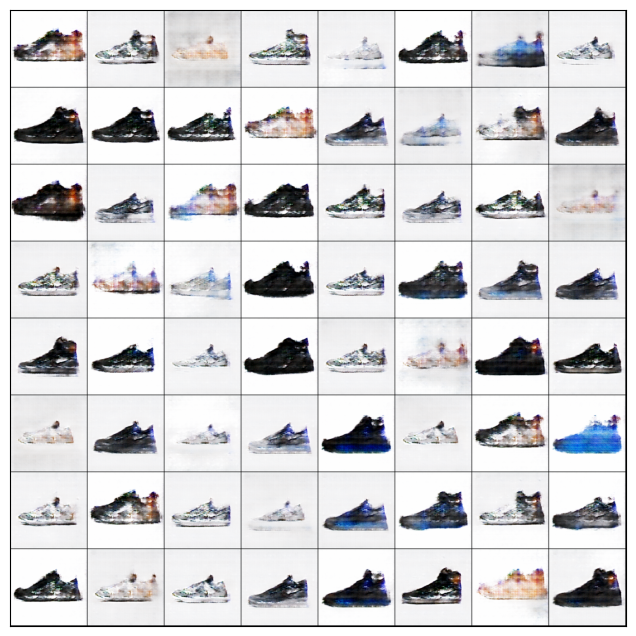

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [12/50], loss_g: 5.3369, loss_d: 0.1098, real_score: 0.9470, fake_score: 0.0504
Saved generated images for epoch 12


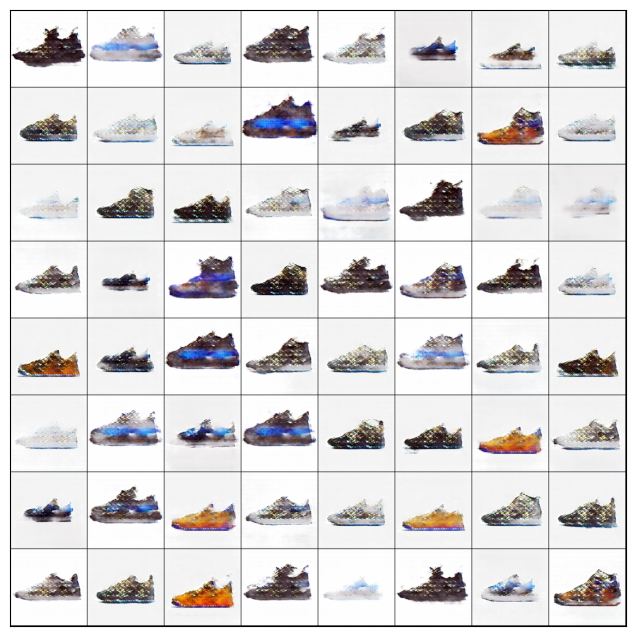

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [13/50], loss_g: 0.8358, loss_d: 0.5011, real_score: 0.6616, fake_score: 0.0103
Saved generated images for epoch 13


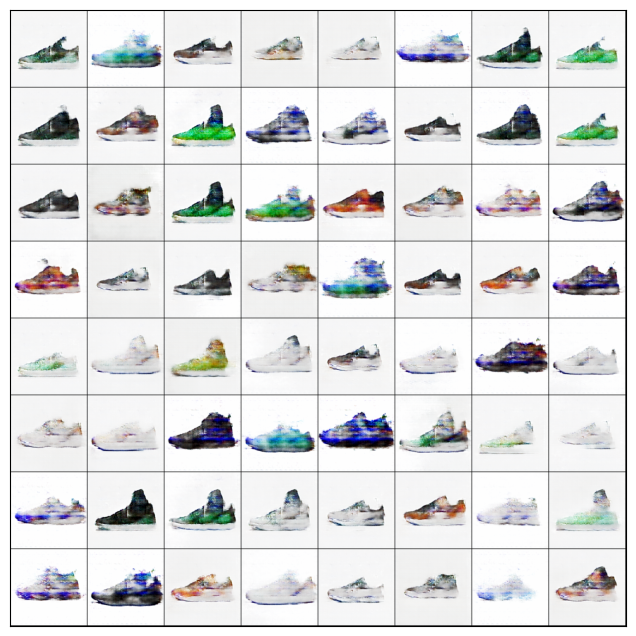

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [14/50], loss_g: 1.8197, loss_d: 0.2787, real_score: 0.7703, fake_score: 0.0056
Saved generated images for epoch 14


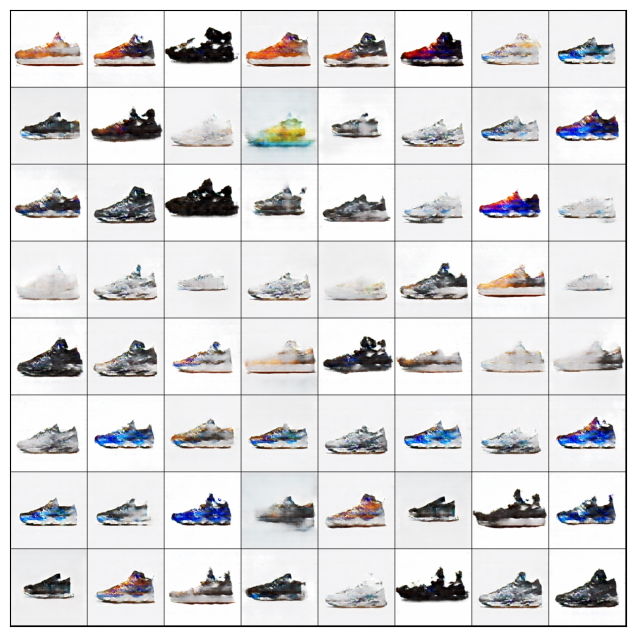

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [15/50], loss_g: 0.8060, loss_d: 0.3484, real_score: 0.7312, fake_score: 0.0036
Saved generated images for epoch 15


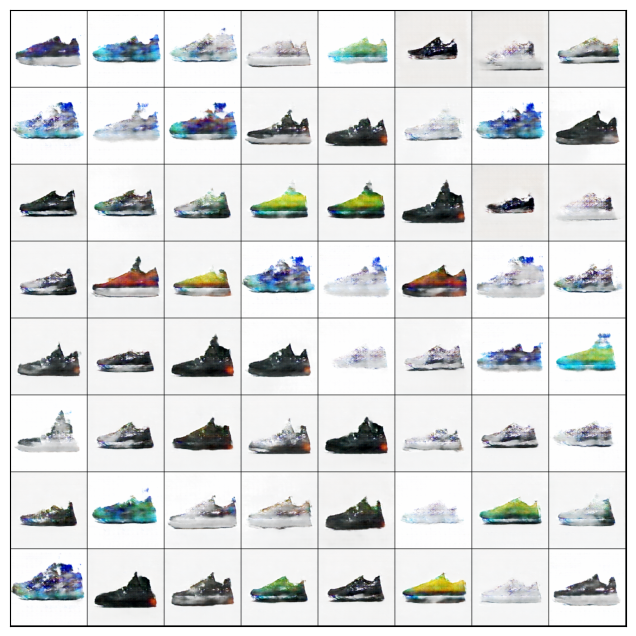

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [16/50], loss_g: 3.6545, loss_d: 0.7905, real_score: 0.6011, fake_score: 0.0880
Saved generated images for epoch 16


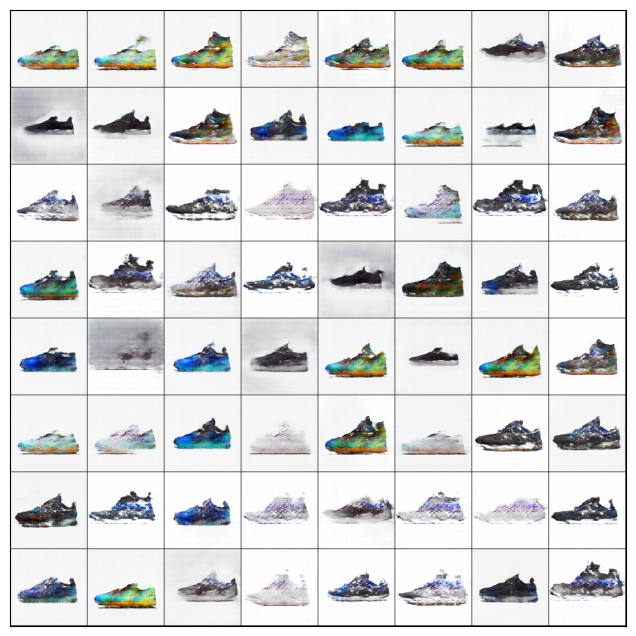

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [17/50], loss_g: 0.1722, loss_d: 1.6681, real_score: 0.2992, fake_score: 0.0482
Saved generated images for epoch 17


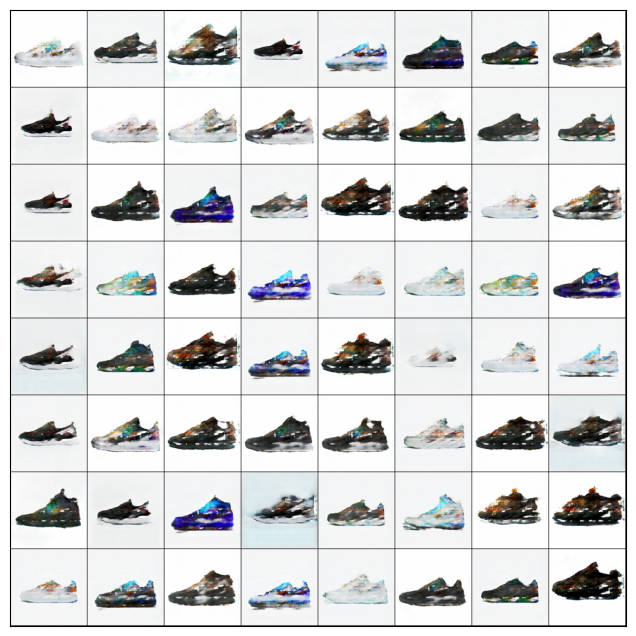

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [18/50], loss_g: 5.0483, loss_d: 0.3005, real_score: 0.8411, fake_score: 0.0065
Saved generated images for epoch 18


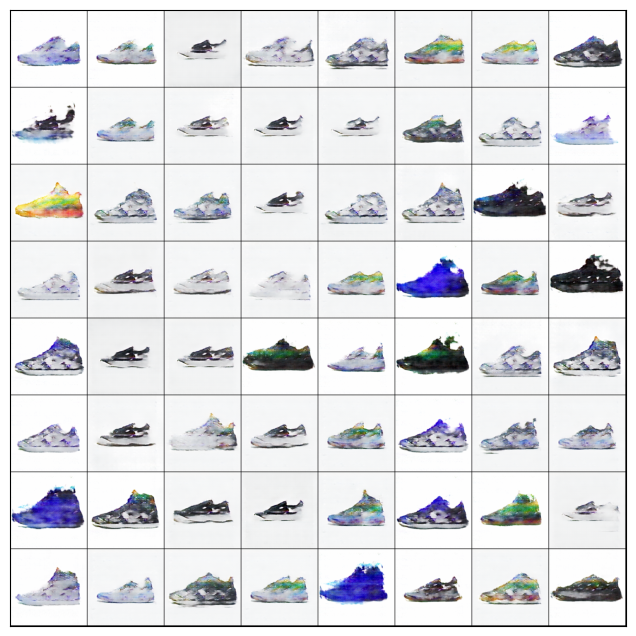

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [19/50], loss_g: 1.5164, loss_d: 1.2596, real_score: 0.4123, fake_score: 0.0131
Saved generated images for epoch 19


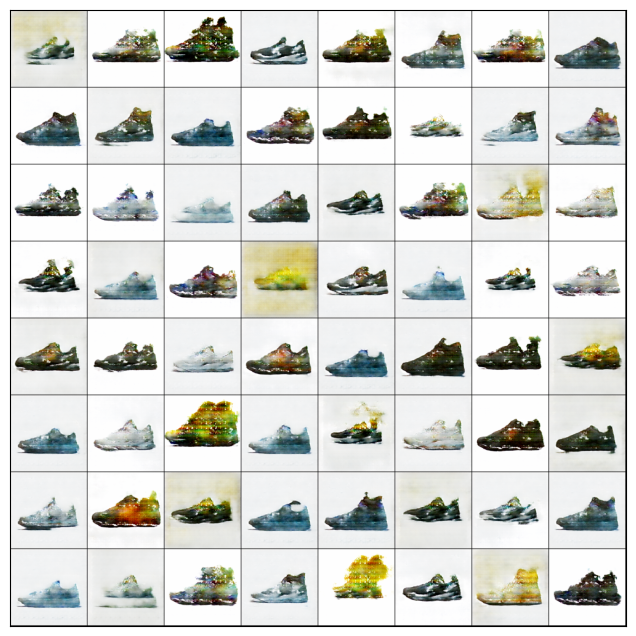

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [20/50], loss_g: 0.0593, loss_d: 1.3557, real_score: 0.3092, fake_score: 0.0822
Saved generated images for epoch 20


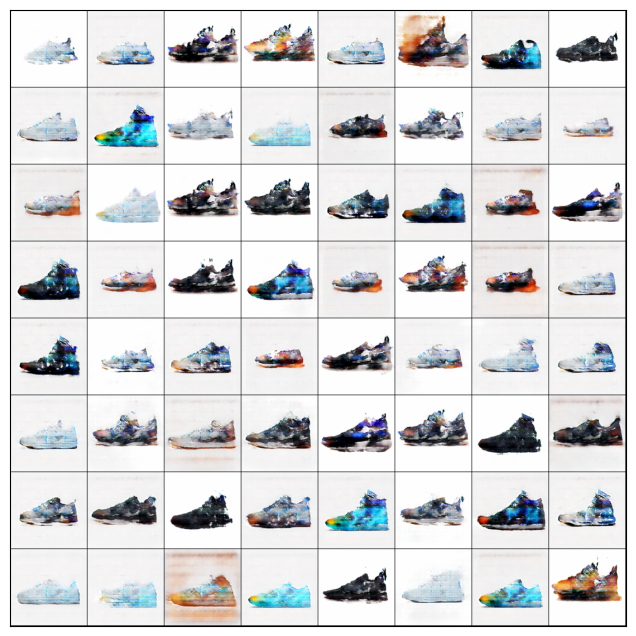

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [21/50], loss_g: 0.7830, loss_d: 0.2857, real_score: 0.7662, fake_score: 0.0136
Saved generated images for epoch 21


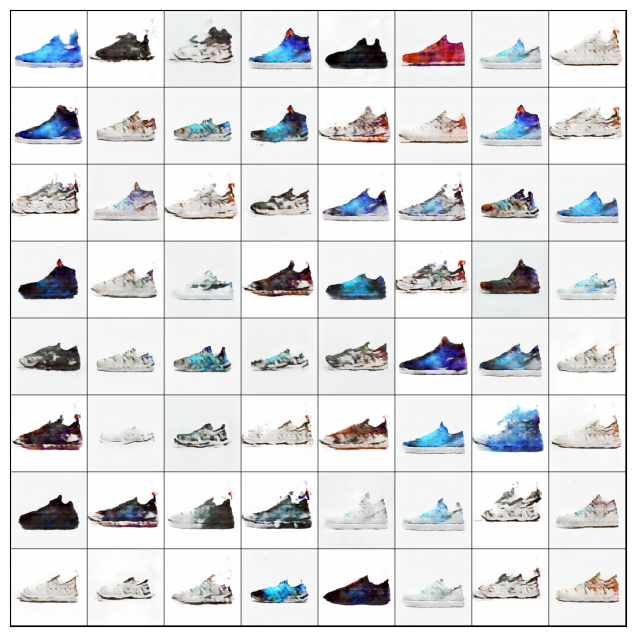

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [22/50], loss_g: 4.2028, loss_d: 0.3845, real_score: 0.7549, fake_score: 0.0442
Saved generated images for epoch 22


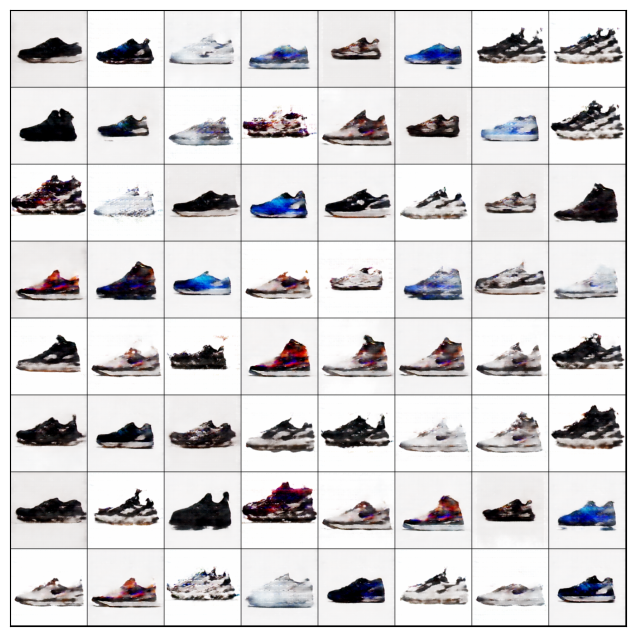

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [23/50], loss_g: 2.0245, loss_d: 0.9959, real_score: 0.5345, fake_score: 0.1652
Saved generated images for epoch 23


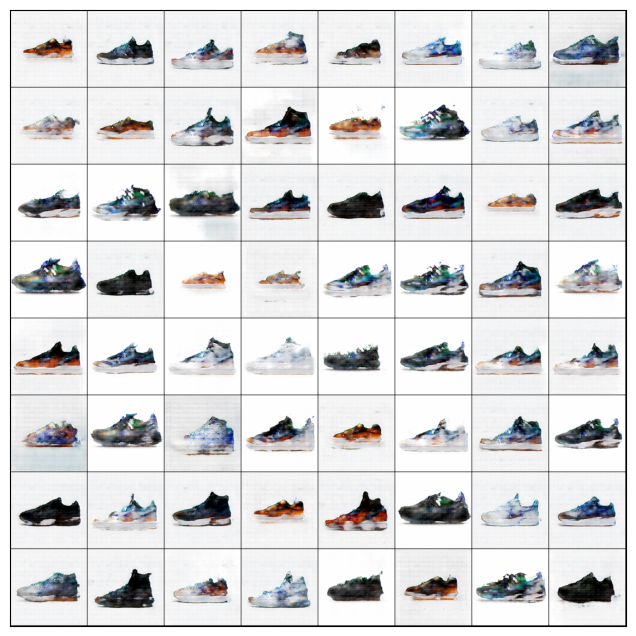

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [24/50], loss_g: 0.3519, loss_d: 1.4087, real_score: 0.4191, fake_score: 0.0215
Saved generated images for epoch 24


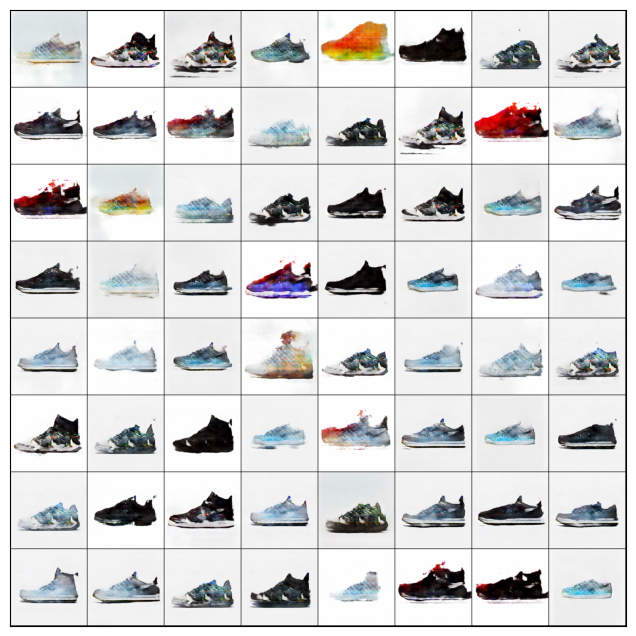

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [25/50], loss_g: 1.0957, loss_d: 0.5858, real_score: 0.6943, fake_score: 0.0197
Saved generated images for epoch 25


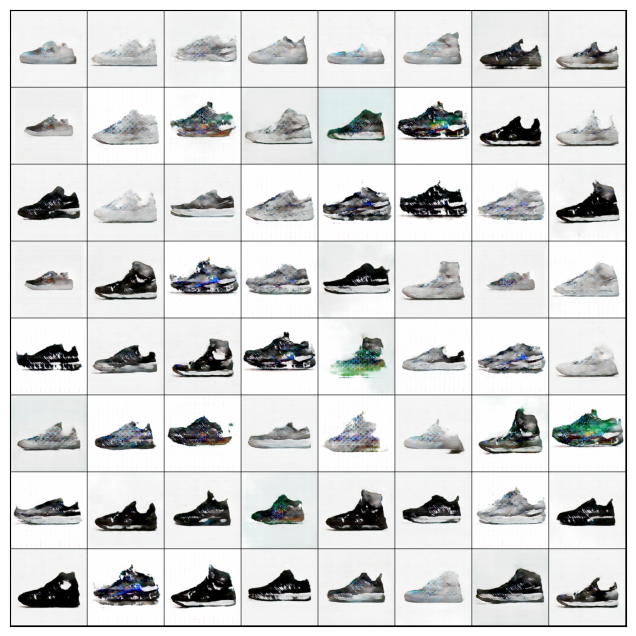

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [26/50], loss_g: 0.0209, loss_d: 2.1737, real_score: 0.2278, fake_score: 0.0029
Saved generated images for epoch 26


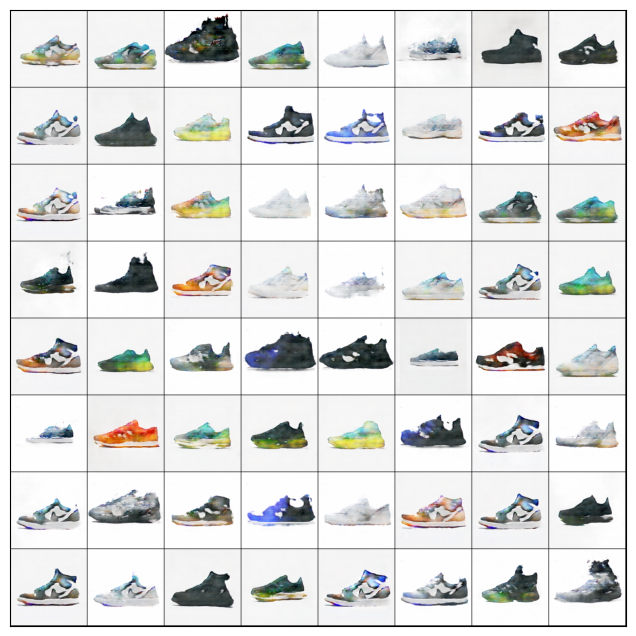

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [27/50], loss_g: 5.6399, loss_d: 0.2129, real_score: 0.8968, fake_score: 0.0648
Saved generated images for epoch 27


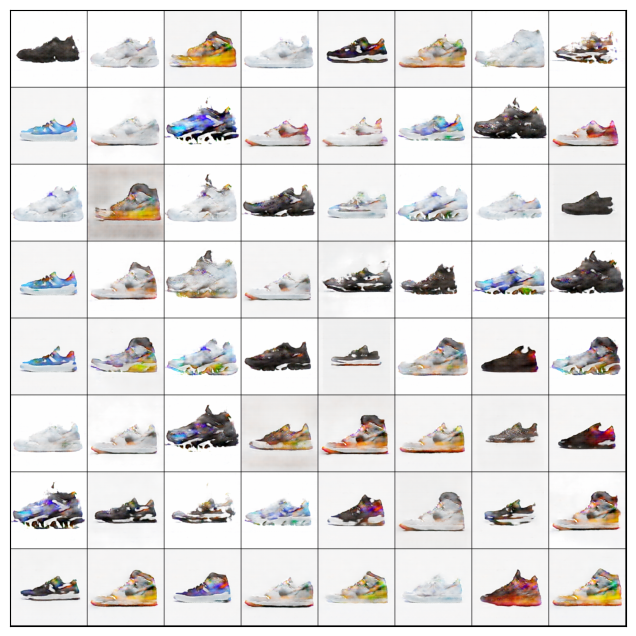

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [28/50], loss_g: 3.2954, loss_d: 0.3285, real_score: 0.8201, fake_score: 0.0935
Saved generated images for epoch 28


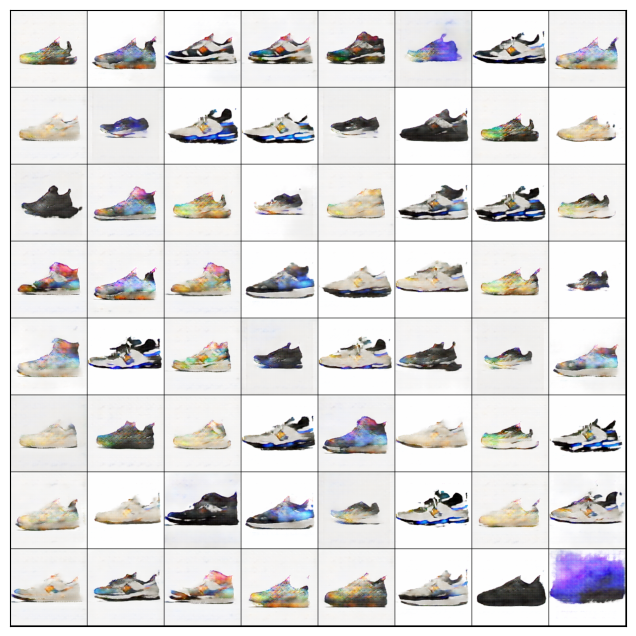

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [29/50], loss_g: 8.3229, loss_d: 4.9307, real_score: 0.1049, fake_score: 0.0000
Saved generated images for epoch 29


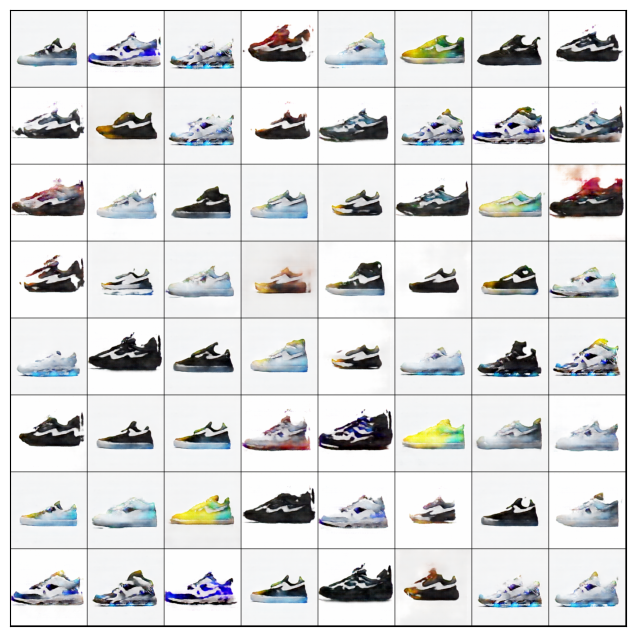

  0%|          | 0/375 [00:00<?, ?it/s]

Epoch [30/50], loss_g: 3.1641, loss_d: 0.4644, real_score: 0.7715, fake_score: 0.1124
Saved generated images for epoch 30


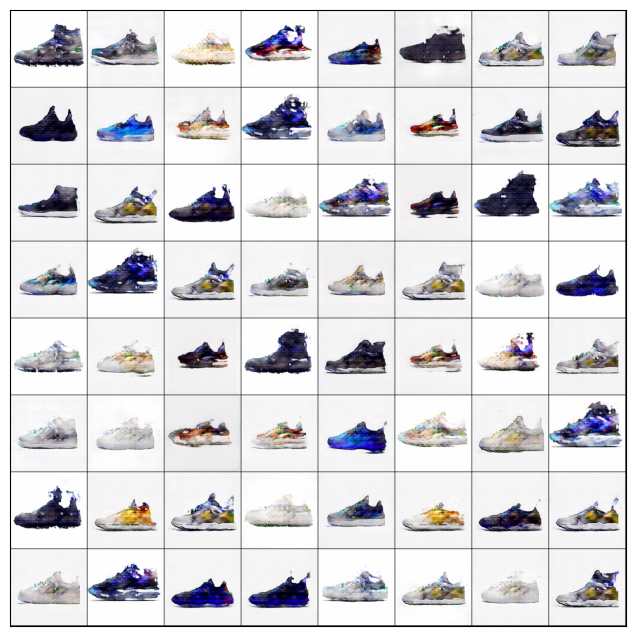

  0%|          | 0/375 [00:00<?, ?it/s]

In [ ]:
L = 256
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator = Generator256(L)
discriminator = Discriminator256()

# Create instance of GAN
gan = GAN(generator, discriminator, device, L)

# Training parameters
epochs = 50
lr = 0.0002
batch_size = 64

# Train the GAN
gan.train(dataload, epochs, lr)

In [49]:
torch.manual_seed(100)
latent_test = torch.randn(1,L,1,1,device=device)
image = generator(latent_test)

In [50]:
image=to_device(image, torch.device("cpu"))
b=image[0].permute(1,2,0).detach().numpy()
b.shape

(128, 128, 3)

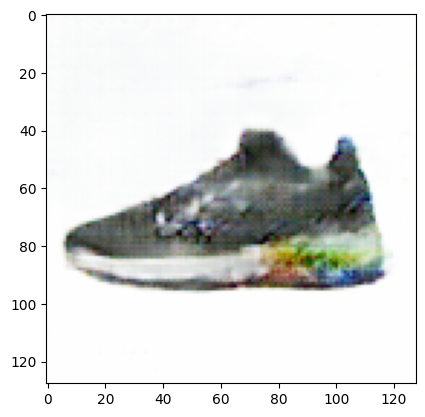

In [51]:
plt.imshow(b)